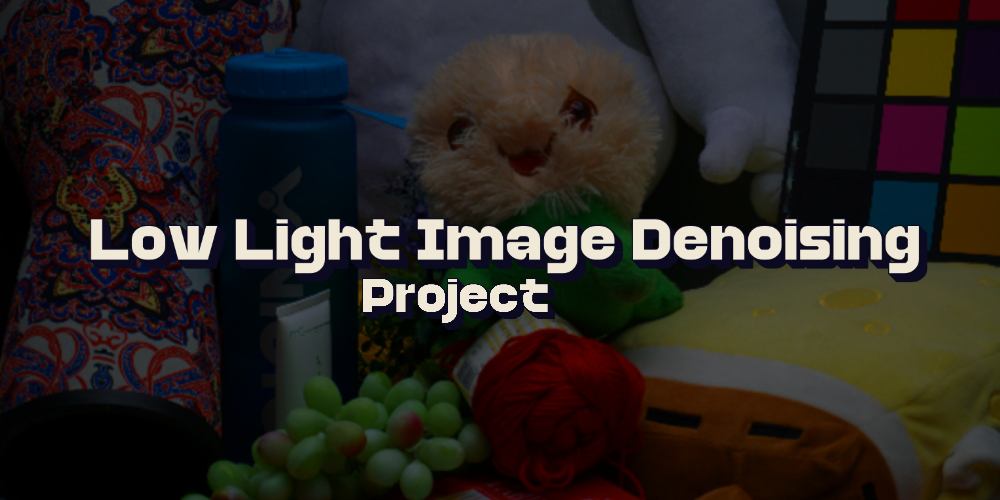

[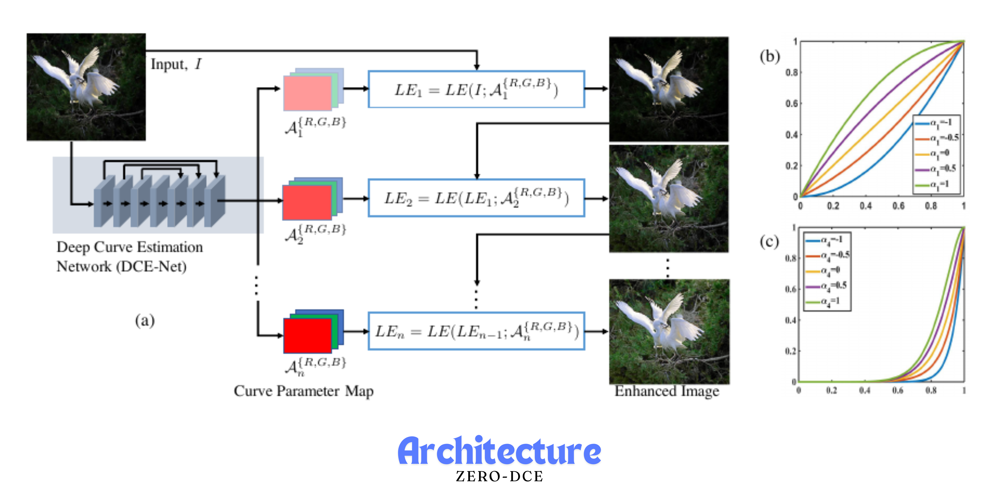](http://)

# **Importing necessary dependencies**

In [14]:
import numpy as np
import pandas as pd
import os

#configuring Keras to use TensorFlow as its backend for deep learning operations.
os.environ["KERAS_BACKEND"] = "tensorflow"

import random
from glob import glob #To retrieve files matching specified patterns.
from PIL import Image, ImageOps
import matplotlib.pyplot as plt #For image plotting
import keras
from keras import layers
import tensorflow as tf #Framework used
from PIL import Image, ImageOps
from tensorflow.keras.models import load_model, save_model #for saving the model

# **Initialization**

In [2]:
Image_Size = 256
Mini_batch_size = 16
Max_Train_Images = 400

# **Loading data and generating dataset**

In [3]:
# Reads an image file from the image_path, decodes it, resizes it to (256,256), and normalizes its pixel values.
def load_data(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(images=image, size=[Image_Size, Image_Size])
    image = image / 255.0
    return image

#Generates a TensorFlow Dataset from a list or tensor low_light_images containing paths to low-light images.
def data_generator(low_light_images):
    dataset = tf.data.Dataset.from_tensor_slices((low_light_images))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(Mini_batch_size, drop_remainder=True)
    return dataset

In [4]:
train_low_light_images = sorted(glob("/kaggle/input/low-light-dataset/lol_dataset/our485/low/*"))[:Max_Train_Images]
val_low_light_images = sorted(glob("/kaggle/input/low-light-dataset/lol_dataset/our485/low/*"))[Max_Train_Images:]
test_low_light_images = sorted(glob("/kaggle/input/low-light-dataset/lol_dataset/eval15/low/*"))


train_dataset = data_generator(train_low_light_images)
val_dataset = data_generator(val_low_light_images)

print("Train Dataset:", train_dataset)
print("Validation Dataset:", val_dataset)

Train Dataset: <_BatchDataset element_spec=TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)>
Validation Dataset: <_BatchDataset element_spec=TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)>


# **Constructing a Deep-Convolutional-Encoder network using Keras layers.**

In [5]:
def DCE_Net():
    input_img = keras.Input(shape=[None, None, 3])
    conv1 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(input_img)
    conv2 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv1)
    conv3 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv2)
    conv4 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv3)
    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])
    conv5 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con1)
    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])
    conv6 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con2)
    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])
    x_r = layers.Conv2D(24, (3, 3), strides=(1, 1), activation="tanh", padding="same")(
        int_con3
    )
    return keras.Model(inputs=input_img, outputs=x_r)

# **Defining the losses**

In [6]:
#Color constancy loss is a measure of how well a model preserves or maintains color consistency across different conditions or illuminations.
def color_constancy_loss(x):
    mean_rgb = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mean_R = tf.reduce_mean(mean_rgb[:, :, :, 0])
    mean_G = tf.reduce_mean(mean_rgb[:, :, :, 1])
    mean_B = tf.reduce_mean(mean_rgb[:, :, :, 2])

    loss_RG = tf.square(mean_R - mean_G)
    loss_RB = tf.square(mean_R - mean_B)
    loss_GB = tf.square(mean_G - mean_B)

    total_loss = loss_RG + loss_RB + loss_GB

    return total_loss

In [7]:
#Exposure loss is a measure of how well the model adjusts the exposure or brightness levels of an image.
def exposure_loss(x, mean_val=0.6):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))
     

In [8]:
#illumination smoothness loss refers to a metric that quantifies how smooth or uniform the illumination appears in an image.
def illumination_smoothness_loss(x):
        sobel_edges = tf.image.sobel_edges(x)
        gradient_x = sobel_edges[:, :, :, :, 0]
        gradient_y = sobel_edges[:, :, :, :, 1]
        smoothness_loss = tf.reduce_mean(tf.square(tf.abs(gradient_x) + tf.abs(gradient_y)))
        return smoothness_loss


In [9]:
#Spatial constancy loss measures the spatial coherence or consistency between different regions or patches within an image.
def spatial_constancy_loss(original_img, enhanced_img, patch_size):
        def gradient(img):
            img = tf.ensure_shape(img, [None, None, None, 3])
            img = tf.image.resize(img, [patch_size, patch_size])
            gradient_y, gradient_x = tf.image.image_gradients(img)
            return gradient_y, gradient_x

        original_gradient_y, original_gradient_x = gradient(original_img)
        enhanced_gradient_y, enhanced_gradient_x = gradient(enhanced_img)

        loss = tf.reduce_mean(tf.square(original_gradient_y - enhanced_gradient_y)) + \
               tf.reduce_mean(tf.square(original_gradient_x - enhanced_gradient_x))
        return loss

# **Wrapping around a DCE network using Class--ZeroDCE**

In [10]:
class ZeroDCE(keras.Model):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.dce_model = DCE_Net()
        self.loss_tracker = {
            "total_loss": keras.metrics.Mean(name="total_loss"),
            "illumination_smoothness_loss": keras.metrics.Mean(name="illumination_smoothness_loss"),
            "spatial_constancy_loss": keras.metrics.Mean(name="spatial_constancy_loss"),
            "color_constancy_loss": keras.metrics.Mean(name="color_constancy_loss"),
            "exposure_loss": keras.metrics.Mean(name="exposure_loss"),
        }

    def compile(self, learning_rate, **kwargs):
        super().compile(**kwargs)
        self.optimizer = keras.optimizers.Adam(learning_rate=learning_rate)

    @property
    def metrics(self):
        return list(self.loss_tracker.values())

    def get_enhanced_image(self, data, output):
        r1 = output[:, :, :, :3]
        r2 = output[:, :, :, 3:6]
        r3 = output[:, :, :, 6:9]
        r4 = output[:, :, :, 9:12]
        r5 = output[:, :, :, 12:15]
        r6 = output[:, :, :, 15:18]
        r7 = output[:, :, :, 18:21]
        r8 = output[:, :, :, 21:24]
        x = data + r1 * (tf.square(data) - data)
        x = x + r2 * (tf.square(x) - x)
        x = x + r3 * (tf.square(x) - x)
        enhanced_image = x + r4 * (tf.square(x) - x)
        x = enhanced_image + r5 * (tf.square(enhanced_image) - enhanced_image)
        x = x + r6 * (tf.square(x) - x)
        x = x + r7 * (tf.square(x) - x)
        enhanced_image = x + r8 * (tf.square(x) - x)
        return enhanced_image

    def call(self, data):
        dce_net_output = self.dce_model(data)
        return self.get_enhanced_image(data, dce_net_output)

    def compute_losses(self, data, output):
        enhanced_image = self.get_enhanced_image(data, output)
        loss_illumination = 200 * illumination_smoothness_loss(output)
        loss_spatial_constancy = tf.reduce_mean(
            spatial_constancy_loss(data,enhanced_image,patch_size=32)
        )
        loss_color_constancy = 5 * tf.reduce_mean(color_constancy_loss(enhanced_image))
        loss_exposure = 10 * tf.reduce_mean(exposure_loss(enhanced_image))
        total_loss = (
            loss_illumination
            + loss_spatial_constancy
            + loss_color_constancy
            + loss_exposure
        )

        return {
            "total_loss": total_loss,
            "illumination_smoothness_loss": loss_illumination,
            "spatial_constancy_loss": loss_spatial_constancy,
            "color_constancy_loss": loss_color_constancy,
            "exposure_loss": loss_exposure,
        }

    def train_step(self, data):
        with tf.GradientTape() as tape:
            output = self.dce_model(data)
            losses = self.compute_losses(data, output)

        gradients = tape.gradient(
            losses["total_loss"], self.dce_model.trainable_weights
        )
        self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))

        self.loss_tracker["total_loss"].update_state(losses["total_loss"])
        self.loss_tracker["illumination_smoothness_loss"].update_state(
            losses["illumination_smoothness_loss"]
        )
        self.loss_tracker["spatial_constancy_loss"].update_state(
            losses["spatial_constancy_loss"]
        )
        self.loss_tracker["color_constancy_loss"].update_state(losses["color_constancy_loss"])
        self.loss_tracker["exposure_loss"].update_state(losses["exposure_loss"])

        return {metric.name: metric.result() for metric in self.metrics}

    def test_step(self, data):
        output = self.dce_model(data)
        losses = self.compute_losses(data, output)

        self.loss_tracker["total_loss"].update_state(losses["total_loss"])
        self.loss_tracker["illumination_smoothness_loss"].update_state(
            losses["illumination_smoothness_loss"]
        )
        self.loss_tracker["spatial_constancy_loss"].update_state(
            losses["spatial_constancy_loss"]
        )
        self.loss_tracker["color_constancy_loss"].update_state(losses["color_constancy_loss"])
        self.loss_tracker["exposure_loss"].update_state(losses["exposure_loss"])


        return {metric.name: metric.result() for metric in self.metrics}

    def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
        self.dce_model.save_weights(
            filepath,
            overwrite=overwrite,
            save_format=save_format,
            options=options,
        )

    def load_weights(self, filepath, by_name=False, skip_mismatch=False, options=None):
        self.dce_model.load_weights(
            filepath=filepath,
            by_name=by_name,
            skip_mismatch=skip_mismatch,
            options=options,
        )

# **Model Compiling and Fitting**

In [11]:
Model_ZeroDCE = ZeroDCE()
Model_ZeroDCE.compile(learning_rate=1e-4)
history = Model_ZeroDCE.fit(train_dataset, validation_data=val_dataset, epochs=100)

Epoch 1/100


I0000 00:00:1718722046.998881     104 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


25/25 ━━━━━━━━━━━━━━━━━━━━ 46s 279ms/step - color_constancy_loss: 0.0022 - exposure_loss: 2.9839 - illumination_smoothness_loss: 0.1133 - spatial_constancy_loss: 1.1335e-05 - total_loss: 3.0995 - val_color_constancy_loss: 0.0014 - val_exposure_loss: 2.9078 - val_illumination_smoothness_loss: 0.1193 - val_spatial_constancy_loss: 4.4073e-05 - val_total_loss: 3.0285
Epoch 2/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 6s 218ms/step - color_constancy_loss: 0.0028 - exposure_loss: 2.9258 - illumination_smoothness_loss: 0.0718 - spatial_constancy_loss: 7.8794e-05 - total_loss: 3.0004 - val_color_constancy_loss: 0.0028 - val_exposure_loss: 2.7849 - val_illumination_smoothness_loss: 0.1177 - val_spatial_constancy_loss: 2.8846e-04 - val_total_loss: 2.9056
Epoch 3/100
25/25 ━━━━━━━━━━━━━━━━━━━━ 5s 217ms/step - color_constancy_loss: 0.0055 - exposure_loss: 2.7553 - illumination_smoothness_loss: 0.1108 - spatial_constancy_loss: 5.3260e-04 - total_loss: 2.8721 - val_color_constancy_loss: 0.0108 - val_exposure_lo

# **Plotting Results and defining Evaluation metric - PSNR Value**

In [12]:
def plot_results(images, titles, figure_size=(12, 12)):
    fig = plt.figure(figsize=figure_size)
    for i in range(len(images)):
        fig.add_subplot(1, len(images), i + 1).set_title(titles[i])
        _ = plt.imshow(images[i])
        plt.axis("off")
    plt.show()


def process(original_image):
    image = keras.utils.img_to_array(original_image)
    image = image.astype("float32")/255
    image = np.expand_dims(image, axis=0)
    output_image = Model_ZeroDCE(image)
    output_image = tf.cast((output_image[0, :, :, :]*255), dtype=np.uint8)
    output_image = Image.fromarray(output_image.numpy())
    return output_image

PSNR value: 27.823380392792522 dB


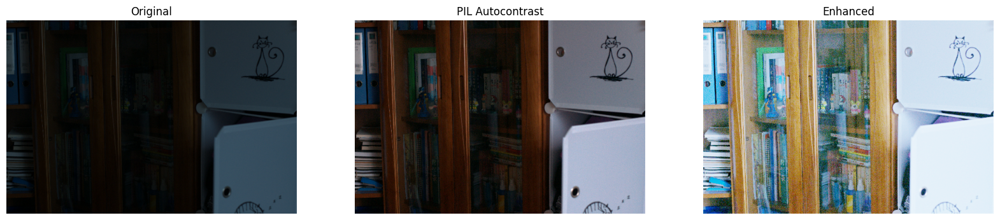

PSNR value: 27.654634779283292 dB


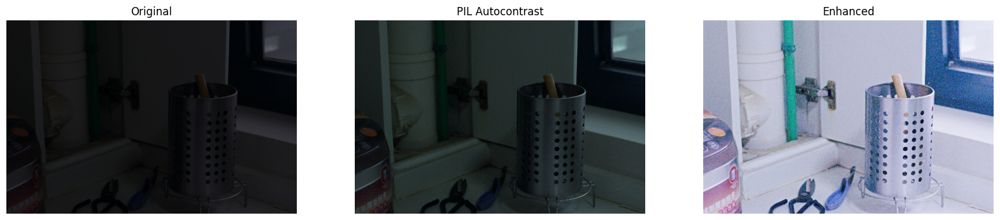

PSNR value: 27.744991401509388 dB


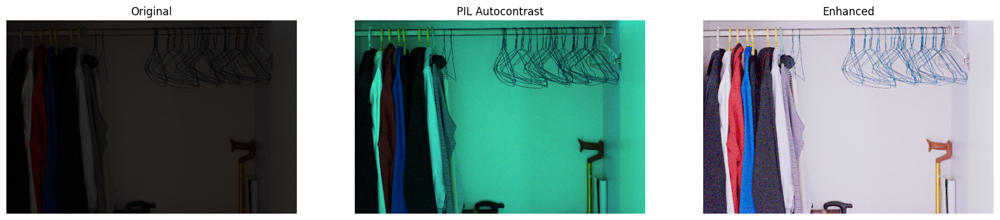

PSNR value: 27.655258995875215 dB


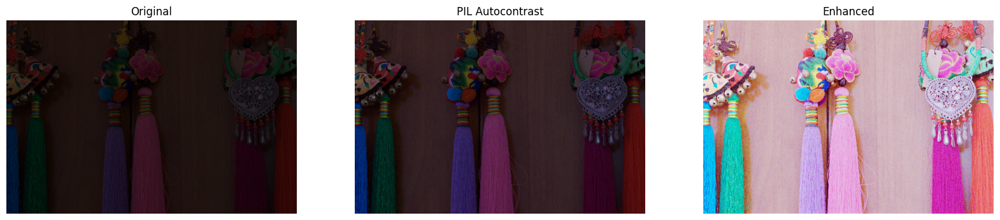

PSNR value: 28.279452295109316 dB


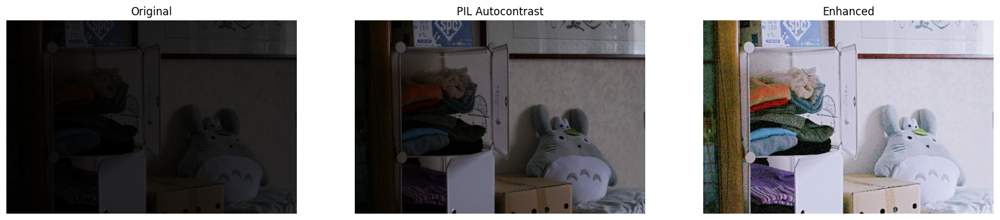

PSNR value: 28.56828426410487 dB


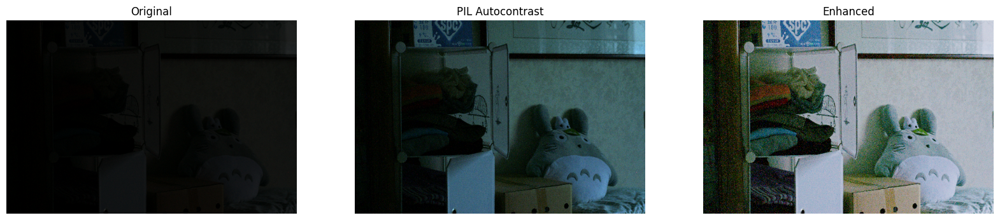

PSNR value: 29.136077417523065 dB


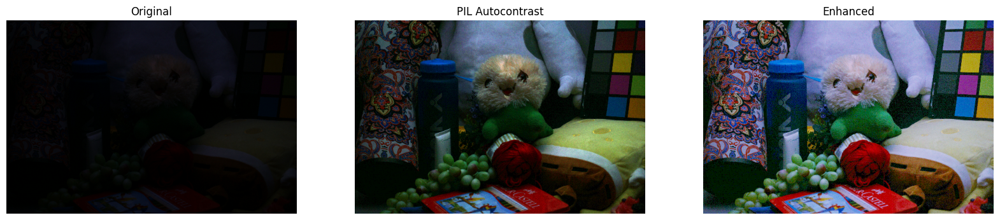

PSNR value: 27.815887938459184 dB


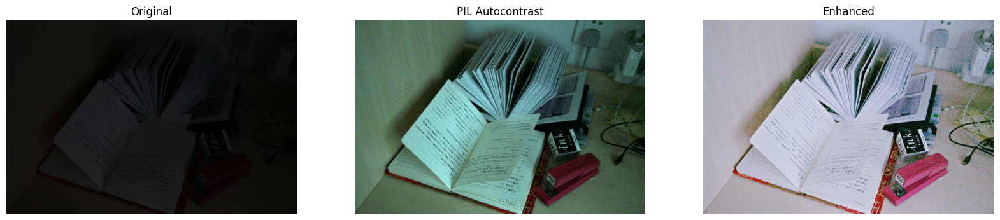

PSNR value: 28.736259244653738 dB


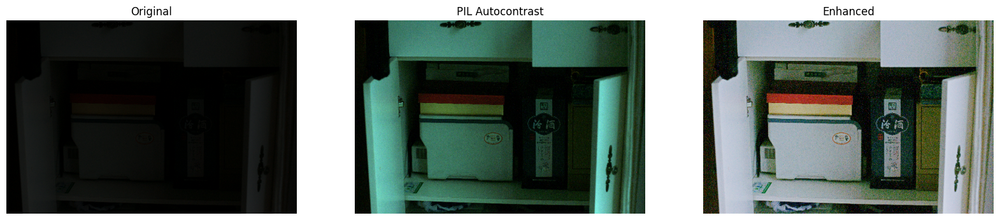

PSNR value: 28.565585493666926 dB


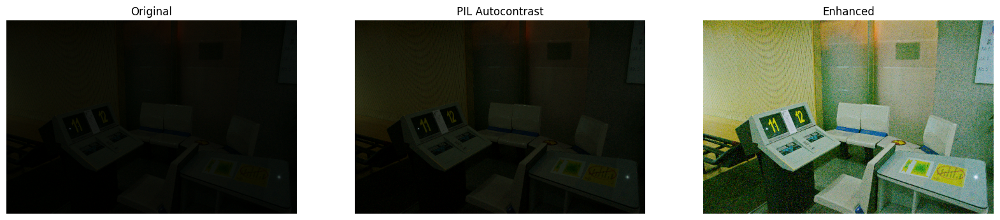

PSNR value: 27.987982630024874 dB


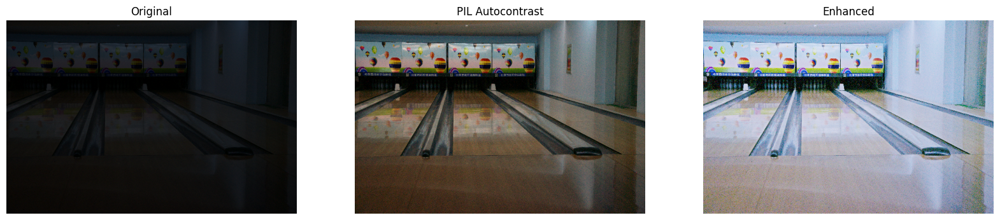

PSNR value: 27.907277010914715 dB


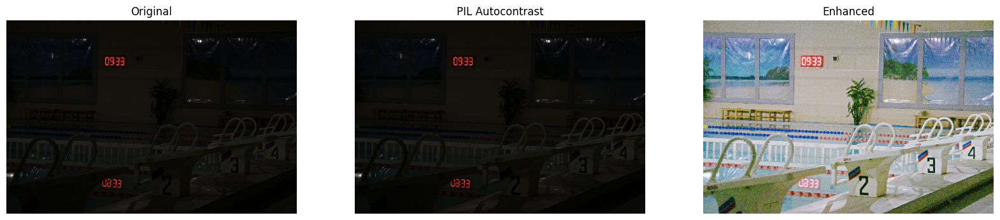

PSNR value: 28.849989268126603 dB


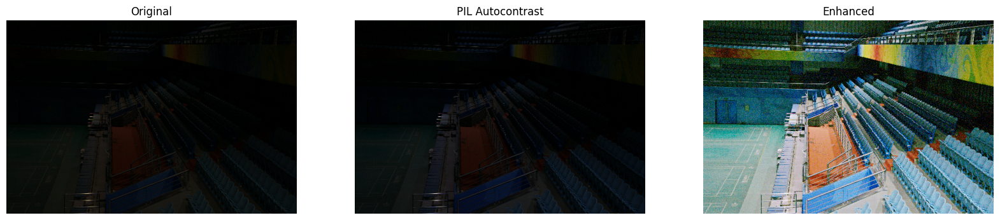

PSNR value: 28.18520491828029 dB


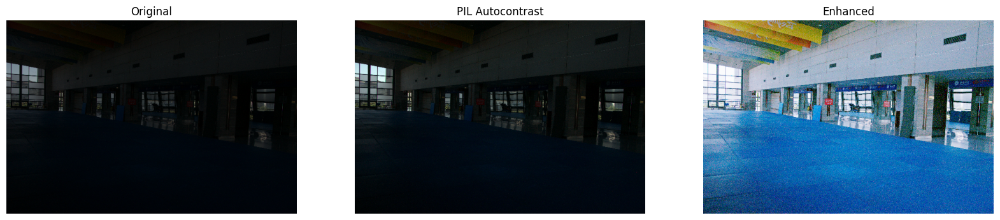

PSNR value: 27.965401862684928 dB


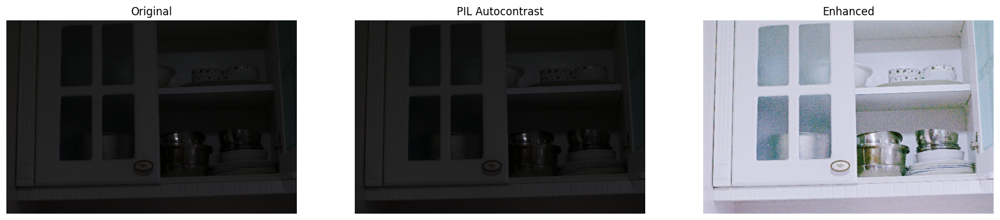

Mean PSNR value: 28.191711194200593 dB


In [13]:
#Calculating individual PSNR values of images
def psnr_val(original, enhanced):
    mse = np.mean((np.array(original) - np.array(enhanced)) ** 2)
    max_pixel = 255.0
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

# Function to calculate mean PSNR
def mean_psnr(psnr_values):
    return np.mean(psnr_values)

# Initializing a list to store PSNR values
psnr_values_list = []

for val_image_file in test_low_light_images:
    original_image = Image.open(val_image_file)
    enhanced_image = process(original_image)
    psnr_value = psnr_val(original_image, enhanced_image)
    psnr_values_list.append(psnr_value)
    print(f"PSNR value: {psnr_value} dB")
    plot_results(
        [original_image, ImageOps.autocontrast(original_image), enhanced_image],
        ["Original", "PIL Autocontrast", "Enhanced"],
        (20, 12),
    )

# Calculating mean PSNR
mean_psnr = mean_psnr(psnr_values_list)
print(f"Mean PSNR value: {mean_psnr} dB")


# **Final Average PSNR Score : 28.197**

In [16]:
save_model(Model_ZeroDCE, 'Zero_DCE_Model.h5')